In [1]:
import pandas as pd
import numpy as np
import re
from nltk.corpus import stopwords
import re
import matplotlib.pyplot as plt
from scipy.interpolate import make_interp_spline

In [2]:
TOP_WORDS = 1000
N = 10

In [3]:
pd.set_option('display.max_columns', None)

In [4]:
with open ('../Data/y_content/y_content.txt', 'r', encoding='utf-8' ) as f:
    text_string_y = f.read()

with open ('../Data/n_content/n_content.txt', 'r', encoding='utf-8' ) as f:
    text_string_n = f.read()

# zipf distribution
- from zipf's law most frequent word will occur approximately twice as often as the second most frequent word, three times as often as the third most frequent word, etc.

    ![Zipf_distribution_CMF](../Picture/Zipf_distribution_CMF.png "Zipf_distribution_CMF") 
    
    Zipf_distribution_CMF

    ![Zipf_distribution_PMF](../Picture/Zipf_distribution_PMF.png "Zipf_distribution_PMF") 
    
    Zipf_distribution_PMF

In [5]:
# Get the percentage value of a given max value
def percentify(value, max):
    return round(value / max * 100)

In [6]:
# Generate smooth curvess
def smoothify(yInput, depth):
    x = np.array(range(0, depth))
    y = np.array(yInput)
    # define x as 600 equally spaced values between the min and max of original x
    x_smooth = np.linspace(x.min(), x.max(), 600) 
    # define spline with degree k=3, which determines the amount of wiggle
    spl = make_interp_spline(x, y, k=3)
    y_smooth = spl(x_smooth)
    # Return the x and y axis
    return x_smooth, y_smooth

In [7]:
def get_most_frequent(text_string:str, remove_stop_word:bool):        
    frequency = {}

    words = re.findall(r'\b[A-Za-z][a-z]{2,9}\b', text_string)
    stop = stopwords.words('english')
    
    for word in words:
        if remove_stop_word:
            if word not in stop:
                count = frequency.get(word,0)
                frequency[word] = count + 1
        else:
            count = frequency.get(word,0)
            frequency[word] = count + 1

    most_frequent = dict(sorted(frequency.items(), key=lambda elem: elem[1], reverse=True))

    return most_frequent

In [8]:
def print_most_frequent(most_frequent:dict):
    top_count = 0
            
    for idx, (words, frequency) in enumerate(most_frequent.items()):
        if idx == 0:
            top_count = frequency
        print(f'{words}: {frequency}: {round(top_count/frequency, 2)}')

In [9]:
def zipf_plot(combined_dict:dict, depth:int, w:int, h:int):
    
    f = plt.figure()
    f.set_figwidth(w)
    f.set_figheight(h)

    ziffianCurveValues = [100/i for i in range(1, depth+1)]
    x, y = smoothify(ziffianCurveValues, depth)
    xAxis = [str(number) for number in range(1, depth+1)]
    plt.plot(x, y, label='Ziffian Curve', ls=':', color='grey')

    for i in combined_dict:
        text_length = sum(combined_dict[i].values())
        maxValue = list(combined_dict[i].values())[0]
        yAxis = [percentify(value, maxValue) for value in list(combined_dict[i].values())[:depth]]
        x, y = smoothify(yAxis, depth)
        plt.plot(x, y, label = i + f' [{text_length}]', lw=1, alpha=0.5)

    plt.xticks(range(0, depth), xAxis)
    plt.legend()
    plt.show()

In [10]:
pure_dict_y = get_most_frequent(text_string_y, remove_stop_word=False)
print_most_frequent(pure_dict_y)

the: 2267464: 1.0
and: 1395684: 1.62
was: 720975: 3.14
for: 499926: 4.54
that: 411556: 5.51
but: 403116: 5.62
with: 386969: 5.86
you: 377959: 6.0
this: 311862: 7.27
they: 282991: 8.01
not: 256155: 8.85
have: 244745: 9.26
good: 240159: 9.44
had: 238393: 9.51
were: 220078: 10.3
place: 210759: 10.76
are: 203820: 11.12
food: 194818: 11.64
there: 176752: 12.83
like: 169958: 13.34
all: 154797: 14.65
here: 154618: 14.66
great: 151725: 14.94
just: 148695: 15.25
out: 143142: 15.84
very: 137259: 16.52
one: 131881: 17.19
really: 125414: 18.08
can: 124907: 18.15
get: 124019: 18.28
their: 117351: 19.32
from: 112376: 20.18
our: 111752: 20.29
some: 109368: 20.73
which: 109241: 20.76
when: 106897: 21.21
time: 105594: 21.47
about: 104971: 21.6
would: 99104: 22.88
service: 98827: 22.94
more: 95759: 23.68
back: 95715: 23.69
what: 95315: 23.79
too: 89259: 25.4
also: 88881: 25.51
your: 85410: 26.55
only: 80118: 28.3
been: 79259: 28.61
don: 78602: 28.85
nice: 75222: 30.14
little: 73467: 30.86
because: 71938

In [11]:
pure_dict_n = get_most_frequent(text_string_n, remove_stop_word=False)
print_most_frequent(pure_dict_n)

the: 3292678: 1.0
and: 2135146: 1.54
was: 998579: 3.3
for: 776425: 4.24
that: 657677: 5.01
you: 615042: 5.35
but: 563062: 5.85
with: 561569: 5.86
this: 499316: 6.59
they: 491159: 6.7
have: 397826: 8.28
not: 374943: 8.78
had: 331655: 9.93
are: 327798: 10.04
were: 303457: 10.85
good: 303142: 10.86
place: 284435: 11.58
there: 280317: 11.75
like: 251566: 13.09
all: 237957: 13.84
food: 237028: 13.89
here: 231315: 14.23
out: 229106: 14.37
just: 222053: 14.83
one: 208834: 15.77
great: 201820: 16.31
very: 198965: 16.55
can: 195387: 16.85
get: 194073: 16.97
from: 192757: 17.08
their: 182495: 18.04
some: 176804: 18.62
really: 176452: 18.66
when: 174777: 18.84
about: 164864: 19.97
time: 162179: 20.3
which: 156446: 21.05
what: 155414: 21.19
our: 153575: 21.44
would: 149220: 22.07
your: 144948: 22.72
more: 143687: 22.92
back: 139690: 23.57
also: 136398: 24.14
service: 130582: 25.22
only: 125838: 26.17
been: 123373: 26.69
don: 120959: 27.22
too: 117424: 28.04
nice: 114997: 28.63
other: 114193: 28.83

In [12]:
dict_y = get_most_frequent(text_string_y, remove_stop_word=True)
print_most_frequent(dict_y)

good: 240159: 1.0
place: 210759: 1.14
food: 194818: 1.23
like: 169958: 1.41
great: 151725: 1.58
one: 131881: 1.82
really: 125414: 1.91
get: 124019: 1.94
time: 105594: 2.27
would: 99104: 2.42
service: 98827: 2.43
back: 95715: 2.51
also: 88881: 2.7
nice: 75222: 3.19
little: 73467: 3.27
well: 70642: 3.4
pretty: 69729: 3.44
got: 68262: 3.52
love: 67368: 3.56
even: 65914: 3.64
best: 65418: 3.67
much: 63809: 3.76
menu: 61865: 3.88
restaurant: 61796: 3.89
people: 61192: 3.92
ordered: 59079: 4.07
bar: 58680: 4.09
think: 56777: 4.23
night: 55537: 4.32
delicious: 55023: 4.36
try: 54930: 4.37
came: 52630: 4.56
went: 52037: 4.62
order: 51931: 4.62
could: 51358: 4.68
chicken: 51304: 4.68
better: 50905: 4.72
definitely: 50604: 4.75
first: 50503: 4.76
always: 49525: 4.85
cheese: 47860: 5.02
come: 47613: 5.04
know: 47570: 5.05
way: 46817: 5.13
two: 46289: 5.19
make: 45907: 5.23
though: 45104: 5.32
wait: 45094: 5.33
bit: 44883: 5.35
table: 44420: 5.41
sauce: 44179: 5.44
made: 43506: 5.52
still: 43142: 

In [13]:
dict_n = get_most_frequent(text_string_n, remove_stop_word=True)
print_most_frequent(dict_n)

good: 303142: 1.0
place: 284435: 1.07
like: 251566: 1.21
food: 237028: 1.28
one: 208834: 1.45
great: 201820: 1.5
get: 194073: 1.56
really: 176452: 1.72
time: 162179: 1.87
would: 149220: 2.03
back: 139690: 2.17
also: 136398: 2.22
service: 130582: 2.32
nice: 114997: 2.64
little: 111549: 2.72
well: 109844: 2.76
even: 105006: 2.89
got: 100872: 3.01
pretty: 97602: 3.11
much: 94156: 3.22
people: 91395: 3.32
love: 88213: 3.44
best: 85841: 3.53
know: 81224: 3.73
could: 80588: 3.76
think: 78794: 3.85
always: 78191: 3.88
restaurant: 76157: 3.98
first: 75869: 4.0
bar: 75369: 4.02
way: 73549: 4.12
make: 73523: 4.12
menu: 73000: 4.15
chicken: 71452: 4.24
two: 71380: 4.25
came: 71218: 4.26
went: 71054: 4.27
try: 70438: 4.3
ordered: 70065: 4.33
better: 69453: 4.36
order: 69422: 4.37
night: 69039: 4.39
come: 68480: 4.43
day: 68210: 4.44
never: 67129: 4.52
right: 66519: 4.56
made: 66074: 4.59
going: 66064: 4.59
friendly: 65931: 4.6
around: 64457: 4.7
want: 64311: 4.71
definitely: 64083: 4.73
still: 633

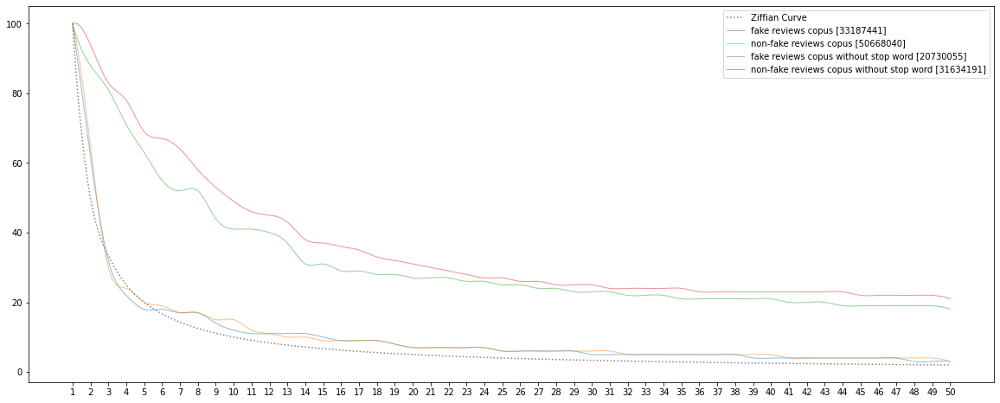

In [14]:
combined_dict = {'fake reviews copus':pure_dict_y, 'non-fake reviews copus':pure_dict_n, 'fake reviews copus without stop word':dict_y, 'non-fake reviews copus without stop word':dict_n}
zipf_plot(combined_dict, 50, 20, 8)

In [15]:
# without stop words
common_keys = dict_y.keys() & dict_n.keys()
common_dict_y = {key: dict_y[key] for key in common_keys}
common_dict_y = dict(sorted(common_dict_y.items(), key=lambda elem: elem[1], reverse=True))
common_dict_n = {key: dict_n[key] for key in common_dict_y.keys()}

# with stop words
pure_common_keys = pure_dict_y.keys() & pure_dict_n.keys()
pure_common_dict_y = {key: pure_dict_y[key] for key in pure_common_keys}
pure_common_dict_y = dict(sorted(pure_common_dict_y.items(), key=lambda elem: elem[1], reverse=True))
pure_common_dict_n = {key: pure_dict_n[key] for key in pure_common_dict_y.keys()}

In [16]:
# without stop words
sum_y = sum(list(common_dict_y.values()))
sum_n = sum(list(common_dict_n.values()))

# with stop words
pure_sum_y = sum(list(pure_common_dict_y.values()))
pure_sum_n = sum(list(pure_common_dict_n.values()))

In [17]:
NUMBER_OF_SELECTED_WORDS = None

In [18]:
# without stop words
words_list = list(common_dict_y.keys())[:NUMBER_OF_SELECTED_WORDS]
prob_common_dict_y = [x/sum_y for x in list(common_dict_y.values())[:NUMBER_OF_SELECTED_WORDS]]
prob_common_dict_n = [x/sum_n for x in list(common_dict_n.values())[:NUMBER_OF_SELECTED_WORDS]]

# with stop words
pure_words_list = list(pure_common_dict_y.keys())[:NUMBER_OF_SELECTED_WORDS]
pure_prob_common_dict_y = [x/pure_sum_y for x in list(pure_common_dict_y.values())[:NUMBER_OF_SELECTED_WORDS]]
pure_prob_common_dict_n = [x/pure_sum_n for x in list(pure_common_dict_n.values())[:NUMBER_OF_SELECTED_WORDS]]

In [19]:
# example of calculating the kl divergence between two mass functions
from math import log2

# calculate the kl divergence
def kl_divergence(p, q):
	return sum(p[i] * log2(p[i]/q[i]) for i in range(len(p)))

def kl_divergence_list(p, q):
	return [p[i] * log2(p[i]/q[i]) for i in range(len(p))]

def delta_kl_divergence_list(p, q):
	kl1 = kl_divergence_list(p, q)
	kl2 = kl_divergence_list(q, p)
	return [kl1[i] - kl2[i] for i in range(len(p))]

In [20]:
# calculate the kl divergence
print('without stop words')
kl_pq = kl_divergence(prob_common_dict_y, prob_common_dict_n)
print('KL(P || Q): %.3f bits' % kl_pq)
kl_qp = kl_divergence(prob_common_dict_n, prob_common_dict_y)
print('KL(Q || P): %.3f bits' % kl_qp)

print('with stop words')
kl_pq = kl_divergence(pure_prob_common_dict_y, pure_prob_common_dict_n)
print('KL(P || Q): %.3f bits' % kl_pq)
kl_qp = kl_divergence(pure_prob_common_dict_n, pure_prob_common_dict_y)
print('KL(Q || P): %.3f bits' % kl_qp)

delta_words = delta_kl_divergence_list(prob_common_dict_y, prob_common_dict_n)
pure_delta_words = delta_kl_divergence_list(pure_prob_common_dict_y, pure_prob_common_dict_n)

without stop words
KL(P || Q): 0.053 bits
KL(Q || P): 0.057 bits
with stop words
KL(P || Q): 0.035 bits
KL(Q || P): 0.037 bits


In [21]:
def print_word_and_delta(words:list, deltas:list):
    print('word: delta_KL')
    for w,d in zip(words, deltas):
        print(f'{w}: {d}')

In [22]:
def print_comporison(words:list, common_dict_y:dict, common_dict_n:dict):
    for word in words:
        y_prob = common_dict_y[word]/sum_y
        n_prob = common_dict_n[word]/sum_n
        status = 'y' if y_prob > n_prob else 'n'
        print(f'{word}: y -> {y_prob}, n -> {n_prob} : {status}')

In [23]:
# without stop words
positive_deltas = [x for x in delta_words if x >= 0]
positive_indexs = [i for i,x in enumerate(delta_words) if x >= 0]
positive_words = [words_list[i] for i in positive_indexs]

# with stop words
pure_positive_deltas = [x for x in pure_delta_words if x >= 0]
pure_positive_indexs = [i for i,x in enumerate(pure_delta_words) if x >= 0]
pure_positive_words = [pure_words_list[i] for i in pure_positive_indexs]

In [24]:
print_word_and_delta(positive_words, positive_deltas)

word: delta_KL
good: 0.005754747358649932
place: 0.0033526322458775947
food: 0.005491732447166125
like: 0.0006658729771823979
great: 0.0026845880285443586
really: 0.0013336313764615998
would: 0.00015637323174436192
service: 0.0018292034001547886
back: 0.0005569241613805296
little: 3.063601407736969e-05
pretty: 0.0007877319836159153
got: 0.0002827591254188114
love: 0.0013208185436584105
best: 0.0012658634736517978
much: 0.00027675732863427505
menu: 0.001955138801144318
restaurant: 0.0016517272472237848
people: 0.00016450244393613513
ordered: 0.0018342235520053289
bar: 0.001285939774784609
think: 0.000703746717949393
night: 0.0014292121559260618
delicious: 0.0020888928649543106
try: 0.001214335134780623
came: 0.0008197371044834384
went: 0.0007517827482330787
order: 0.0008870894981348391
chicken: 0.0006126391256769152
better: 0.0007405142616280031
definitely: 0.001193359272320657
first: 9.55376041412168e-05
cheese: 0.0011327287062519037
come: 0.00036951090761171916
though: 0.0006403421410

In [25]:
print_comporison(positive_words, common_dict_y, common_dict_n)

good: y -> 0.011618915029943892, n -> 0.009630307777065533 : y
place: y -> 0.01019654026205949, n -> 0.009036018079215795 : y
food: y -> 0.009425313181282438, n -> 0.007529978002989652 : y
like: y -> 0.00822258404081964, n -> 0.007991825633680808 : y
great: y -> 0.0073404697842605815, n -> 0.006411479490032281 : y
really: y -> 0.006067541127192332, n -> 0.005605581106803964 : y
would: y -> 0.004794660850218228, n -> 0.004740466601439981 : y
service: y -> 0.004781259564139861, n -> 0.004148368916695052 : y
back: y -> 0.004630700711158356, n -> 0.004437714646529627 : y
little: y -> 0.0035543403766041992, n -> 0.0035437227511327467 : y
pretty: y -> 0.003373495584687468, n -> 0.003100650189208853 : y
got: y -> 0.003302521986575685, n -> 0.003204532549393203 : y
love: y -> 0.0032592701824094043, n -> 0.002802377565425714 : y
best: y -> 0.0031649289988252343, n -> 0.002727023143909727 : y
much: y -> 0.0030870854273447584, n -> 0.0029911766071919507 : y
menu: y -> 0.002993034524325463, n -> 0

In [26]:
print_word_and_delta(pure_positive_words, pure_positive_deltas)

word: delta_KL
the: 0.00941158487790208
was: 0.005759928512281376
but: 0.0029497264033207663
with: 0.001627038504745788
not: 0.0008934963421367936
good: 0.0036123162674694276
had: 0.0018203087576381914
were: 0.0018360896420595043
place: 0.0021120658024688303
food: 0.0034435601347852945
like: 0.0004332618932520607
here: 0.00025391287712991776
great: 0.0016893896524787333
just: 0.0002670916306708671
very: 0.0005899825862485191
really: 0.0008446165316113407
our: 0.0009618622698872654
which: 0.0005784760687561533
would: 0.00010811958689113712
service: 0.0011506150878951619
more: 0.0001328313160664186
back: 0.00035737432460286166
too: 0.0010688348683938033
little: 2.7001984948903858e-05
pretty: 0.0004984196283595631
got: 0.00018356130218138788
love: 0.000830400736802681
best: 0.000795941696482291
much: 0.00017934168864086828
menu: 0.0012251643565834597
restaurant: 0.0010360466896098622
after: 3.8819261595948864e-05
people: 0.00010910382987527119
ordered: 0.0011495043379918589
bar: 0.0008077

In [27]:
print_comporison(pure_positive_words, pure_common_dict_y, pure_common_dict_n)

the: y -> 0.10970012179204901, n -> 0.1046028018247969 : y
was: y -> 0.034880838376716246, n -> 0.03172316310413708 : y
but: y -> 0.01950279003164929, n -> 0.017887525837957368 : y
with: y -> 0.01872159665147822, n -> 0.017840095757298276 : y
not: y -> 0.012392803015898957, n -> 0.011911303906605756 : y
good: y -> 0.011618915029943892, n -> 0.009630307777065533 : y
had: y -> 0.011533475783682535, n -> 0.010536117482244853 : y
were: y -> 0.010647394359403527, n -> 0.009640314793413566 : y
place: y -> 0.01019654026205949, n -> 0.009036018079215795 : y
food: y -> 0.009425313181282438, n -> 0.007529978002989652 : y
like: y -> 0.00822258404081964, n -> 0.007991825633680808 : y
here: y -> 0.007480433396624173, n -> 0.007348485671572773 : y
great: y -> 0.0073404697842605815, n -> 0.006411479490032281 : y
just: y -> 0.007193878098999026, n -> 0.007054247622634714 : y
very: y -> 0.00664060334234848, n -> 0.0063207809767826416 : y
really: y -> 0.006067541127192332, n -> 0.005605581106803964 : y


In [28]:
# without stop words
negative_deltas = [x for x in delta_words if x < 0]
negative_indexs = [i for i,x in enumerate(delta_words) if x < 0]
negative_words = [words_list[i] for i in negative_indexs]

# with stop words
pure_negative_deltas = [x for x in pure_delta_words if x < 0]
pure_negative_indexs = [i for i,x in enumerate(pure_delta_words) if x < 0]
pure_negative_words = [pure_words_list[i] for i in pure_negative_indexs]

In [29]:
print_word_and_delta(negative_words, negative_deltas)

word: delta_KL
one: -0.000732656530800079
get: -0.0004770406945369363
time: -0.00012552796246347617
also: -9.539791378205617e-05
nice: -4.0431370333865766e-05
well: -0.00020744158566915038
even: -0.0004240428336502142
could: -0.00021768820254229268
always: -0.0002538594257649789
know: -0.0008056351132934792
way: -0.00020636892602402565
two: -8.124064240822204e-05
make: -0.00033107085585897287
never: -0.0003006938918073392
right: -0.000327439592662972
going: -0.00030400358635347213
want: -0.00016112804466505672
around: -0.000401229210771088
day: -0.0009272736332322431
friendly: -0.0008509118180646874
see: -0.0005444136833657391
since: -0.0001669227498294436
sure: -0.00014631519688375563
take: -0.00038668914522845183
something: -0.00023040539988067007
pizza: -0.0004815265030931945
staff: -0.000761402973952052
many: -0.00014942639016961973
lot: -0.00041440612495883167
area: -0.000865929411697205
new: -0.0009792935139825683
find: -0.0011816283286819693
every: -0.0002063554960137427
hot: -0

In [30]:
print_comporison(negative_words, common_dict_y, common_dict_n)

one: y -> 0.006380415196032755, n -> 0.006634302387381832 : n
get: y -> 0.006000050895859041, n -> 0.006165370424482385 : n
time: y -> 0.005108647661224003, n -> 0.0051521520771675025 : n
also: y -> 0.004300071147766451, n -> 0.004333133383616208 : n
nice: y -> 0.003639247441829952, n -> 0.0036532598697613826 : n
well: y -> 0.0034176666106425176, n -> 0.0034895577896298974 : n
even: y -> 0.0031889255255215156, n -> 0.0033358627258464457 : n
could: y -> 0.002484704875136299, n -> 0.002560144233191564 : n
always: y -> 0.0023960241625671794, n -> 0.0024839956040289073 : n
know: y -> 0.0023014410785122813, n -> 0.002580348875722832 : n
way: y -> 0.002265010867620548, n -> 0.0023365271281953434 : n
two: y -> 0.0022394661779116037, n -> 0.0022676216727703113 : n
make: y -> 0.0022209849819479354, n -> 0.0023357011522428073 : n
never: y -> 0.0020283838271537924, n -> 0.002132574604530656 : n
right: y -> 0.0019997428114195215, n -> 0.002113195937951924 : n
going: y -> 0.001993405019086431, n ->

In [31]:
print_word_and_delta(pure_negative_words, pure_negative_deltas)

word: delta_KL
and: -0.00040111546526503316
for: -0.0008079250741808823
that: -0.0017220529395680683
you: -0.002213396205917299
this: -0.00135935218170238
they: -0.003412575252705688
have: -0.0014080756030254843
are: -0.0009722053560367041
there: -0.0006174342023990613
all: -0.00010991619880598724
out: -0.0006195992776148991
one: -0.0004423718372071594
can: -0.00028164036426092545
get: -0.0002839266232439999
their: -0.00020333339773604986
from: -0.0012242625373307188
some: -0.00057372767893476
when: -0.000673274773528107
time: -6.685698875942976e-05
about: -0.00027451608154709616
what: -0.0005759428985338026
also: -4.988009937009701e-05
your: -0.0008414120667887752
only: -0.00020993881986315762
been: -0.00014393957757042464
don: -6.32648636784128e-05
nice: -1.7096821912657902e-05
because: -5.693533720505915e-05
other: -0.0003641813288815299
well: -0.00012166659642221133
will: -0.0003821185450574751
even: -0.0002571544258226917
than: -0.00018071818049500166
has: -0.0007636413167605345
t

In [32]:
print_comporison(pure_negative_words, pure_common_dict_y, pure_common_dict_n)

and: y -> 0.06752332331768625, n -> 0.06782997119821854 : n
for: y -> 0.02418646694589722, n -> 0.02466570688260982 : n
that: y -> 0.019911118026239235, n -> 0.02089328409754217 : n
you: y -> 0.01828569200322521, n -> 0.01953884237691227 : n
this: y -> 0.015087912920475026, n -> 0.015862423412174007 : n
they: y -> 0.013691131222393713, n -> 0.015603289341218735 : n
have: y -> 0.0118407861416962, n -> 0.012638258049755139 : n
are: y -> 0.009860830788782282, n -> 0.010413587126516707 : n
there: y -> 0.008551278400445715, n -> 0.00890519619565642 : n
all: y -> 0.007489093433476258, n -> 0.007559490759139885 : n
out: y -> 0.006925223436207798, n -> 0.00727830948391307 : n
one: y -> 0.006380415196032755, n -> 0.006634302387381832 : n
can: y -> 0.006043012419460448, n -> 0.006207113978391326 : n
get: y -> 0.006000050895859041, n -> 0.006165370424482385 : n
their: y -> 0.005677452428095327, n -> 0.005797556979156878 : n
from: y -> 0.00543676145972033, n -> 0.00612356333396171 : n
some: y -> 0

In [33]:
delta_words_dict = {words_list[i]: delta_words[i] for i in range(len(delta_words))}
pure_delta_words_dict = {pure_words_list[i]: pure_delta_words[i] for i in range(len(pure_delta_words))}

In [34]:
delta_words_dict = dict(sorted(delta_words_dict.items(), key=lambda elem: elem[1], reverse=True))
pure_delta_words_dict = dict(sorted(pure_delta_words_dict.items(), key=lambda elem: elem[1], reverse=True))

In [35]:
delta_words_dict

{'good': 0.005754747358649932,
 'food': 0.005491732447166125,
 'place': 0.0033526322458775947,
 'great': 0.0026845880285443586,
 'delicious': 0.0020888928649543106,
 'menu': 0.001955138801144318,
 'ordered': 0.0018342235520053289,
 'service': 0.0018292034001547886,
 'table': 0.001738048067631506,
 'restaurant': 0.0016517272472237848,
 'burger': 0.0016510876752886899,
 'wait': 0.0016033616883232428,
 'night': 0.0014292121559260618,
 'dinner': 0.0013643911566400449,
 'dish': 0.001359855007176124,
 'really': 0.0013336313764615998,
 'love': 0.0013208185436584105,
 'bar': 0.001285939774784609,
 'drinks': 0.0012774171002316492,
 'best': 0.0012658634736517978,
 'sushi': 0.0012583621553434788,
 'dessert': 0.0012577717686208753,
 'try': 0.001214335134780623,
 'meal': 0.001207389587808444,
 'tasty': 0.0011999542242363548,
 'definitely': 0.001193359272320657,
 'cheese': 0.0011327287062519037,
 'sauce': 0.001123547211035583,
 'eat': 0.0010893748488005166,
 'atmosphere': 0.0010792499277478408,
 'fr

In [36]:
pure_delta_words_dict

{'the': 0.00941158487790208,
 'was': 0.005759928512281376,
 'good': 0.0036123162674694276,
 'food': 0.0034435601347852945,
 'but': 0.0029497264033207663,
 'place': 0.0021120658024688303,
 'were': 0.0018360896420595043,
 'had': 0.0018203087576381914,
 'great': 0.0016893896524787333,
 'with': 0.001627038504745788,
 'delicious': 0.0013078129799599465,
 'menu': 0.0012251643565834597,
 'service': 0.0011506150878951619,
 'ordered': 0.0011495043379918589,
 'table': 0.0010880136930892439,
 'too': 0.0010688348683938033,
 'restaurant': 0.0010360466896098622,
 'burger': 0.0010322001707788726,
 'wait': 0.0010041322533017132,
 'our': 0.0009618622698872654,
 'night': 0.0008966939098546872,
 'not': 0.0008934963421367936,
 'dinner': 0.0008546792137910579,
 'dish': 0.0008511298582662054,
 'really': 0.0008446165316113407,
 'love': 0.000830400736802681,
 'bar': 0.0008077335093614555,
 'drinks': 0.000799761489951705,
 'best': 0.000795941696482291,
 'sushi': 0.000787190700298534,
 'dessert': 0.000786512723

In [37]:
def plot_words_distribution(p:list, q:list, x_axis:list, w:int, h:int, n:int):
    print('P=%.3f Q=%.3f' % (sum(p), sum(q)))

    f = plt.figure()
    f.set_figwidth(w)
    f.set_figheight(h)

    # plot first distribution
    plt.subplot(2,1,1)
    plt.bar(x_axis[:n], p[:n])
    # plot second distribution
    plt.subplot(2,1,2)
    plt.bar(x_axis[:n], q[:n])
    # show the plot
    plt.show()

P=1.000 Q=1.000


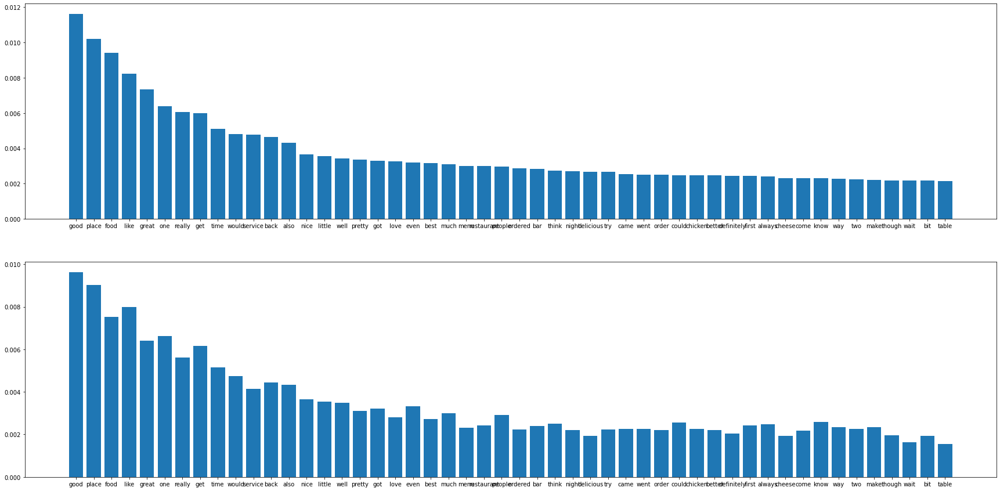

In [38]:
plot_words_distribution(prob_common_dict_y, prob_common_dict_n, words_list, 30, 15, 50)

P=1.000 Q=1.000


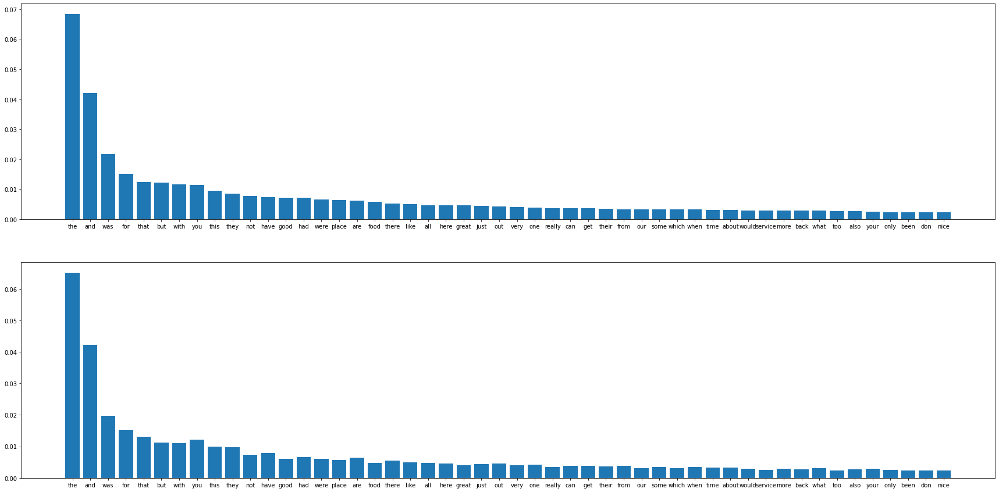

In [39]:
plot_words_distribution(pure_prob_common_dict_y, pure_prob_common_dict_n, pure_words_list, 30, 15, 50)

In [40]:
abs_delta_words_dict = {words_list[i]: abs(delta_words[i]) for i in range(len(delta_words))}
pure_abs_delta_words_dict = {pure_words_list[i]: abs(pure_delta_words[i]) for i in range(len(pure_delta_words))}

In [41]:
abs_delta_words_dict = dict(sorted(abs_delta_words_dict.items(), key=lambda elem: elem[1], reverse=True))
pure_abs_delta_words_dict = dict(sorted(pure_abs_delta_words_dict.items(), key=lambda elem: elem[1], reverse=True))

In [42]:
top_words = list(abs_delta_words_dict.keys())[:TOP_WORDS]
pure_top_words = list(pure_abs_delta_words_dict.keys())[:TOP_WORDS]

In [43]:
for i in top_words:
    print(f'{i}: {delta_words_dict[i]}')

good: 0.005754747358649932
food: 0.005491732447166125
place: 0.0033526322458775947
store: -0.0030887305759956093
great: 0.0026845880285443586
delicious: 0.0020888928649543106
menu: 0.001955138801144318
ordered: 0.0018342235520053289
service: 0.0018292034001547886
table: 0.001738048067631506
restaurant: 0.0016517272472237848
burger: 0.0016510876752886899
wait: 0.0016033616883232428
night: 0.0014292121559260618
dinner: 0.0013643911566400449
dish: 0.001359855007176124
really: 0.0013336313764615998
love: 0.0013208185436584105
bar: 0.001285939774784609
drinks: 0.0012774171002316492
car: -0.0012678332055952883
best: 0.0012658634736517978
sushi: 0.0012583621553434788
dessert: 0.0012577717686208753
try: 0.001214335134780623
meal: 0.001207389587808444
work: -0.0012037543405410524
tasty: 0.0011999542242363548
definitely: 0.001193359272320657
find: -0.0011816283286819693
cheese: 0.0011327287062519037
sauce: 0.001123547211035583
shop: -0.0011197130649667163
eat: 0.0010893748488005166
atmosphere: 0

In [44]:
for i in pure_top_words:
    print(f'{i}: {pure_delta_words_dict[i]}')

the: 0.00941158487790208
was: 0.005759928512281376
good: 0.0036123162674694276
food: 0.0034435601347852945
they: -0.003412575252705688
but: 0.0029497264033207663
you: -0.002213396205917299
place: 0.0021120658024688303
store: -0.0019229404821748787
were: 0.0018360896420595043
had: 0.0018203087576381914
that: -0.0017220529395680683
great: 0.0016893896524787333
she: -0.0016622783736176755
with: 0.001627038504745788
have: -0.0014080756030254843
this: -0.00135935218170238
delicious: 0.0013078129799599465
menu: 0.0012251643565834597
from: -0.0012242625373307188
service: 0.0011506150878951619
ordered: 0.0011495043379918589
table: 0.0010880136930892439
too: 0.0010688348683938033
restaurant: 0.0010360466896098622
burger: 0.0010322001707788726
her: -0.0010138430917616807
wait: 0.0010041322533017132
are: -0.0009722053560367041
our: 0.0009618622698872654
them: -0.0009156873586615825
night: 0.0008966939098546872
not: 0.0008934963421367936
dinner: 0.0008546792137910579
dish: 0.0008511298582662054
re

In [45]:
# without stop words
top_words_y = {i:delta_words_dict[i] for i in top_words if delta_words_dict[i] > 0}
top_words_n = {i:delta_words_dict[i] for i in top_words if delta_words_dict[i] < 0}

# with stop words
pure_top_words_y = {i:pure_delta_words_dict[i] for i in pure_top_words if pure_delta_words_dict[i] > 0}
pure_top_words_n = {i:pure_delta_words_dict[i]  for i in pure_top_words if pure_delta_words_dict[i] < 0}


In [46]:
top_words_y

{'good': 0.005754747358649932,
 'food': 0.005491732447166125,
 'place': 0.0033526322458775947,
 'great': 0.0026845880285443586,
 'delicious': 0.0020888928649543106,
 'menu': 0.001955138801144318,
 'ordered': 0.0018342235520053289,
 'service': 0.0018292034001547886,
 'table': 0.001738048067631506,
 'restaurant': 0.0016517272472237848,
 'burger': 0.0016510876752886899,
 'wait': 0.0016033616883232428,
 'night': 0.0014292121559260618,
 'dinner': 0.0013643911566400449,
 'dish': 0.001359855007176124,
 'really': 0.0013336313764615998,
 'love': 0.0013208185436584105,
 'bar': 0.001285939774784609,
 'drinks': 0.0012774171002316492,
 'best': 0.0012658634736517978,
 'sushi': 0.0012583621553434788,
 'dessert': 0.0012577717686208753,
 'try': 0.001214335134780623,
 'meal': 0.001207389587808444,
 'tasty': 0.0011999542242363548,
 'definitely': 0.001193359272320657,
 'cheese': 0.0011327287062519037,
 'sauce': 0.001123547211035583,
 'eat': 0.0010893748488005166,
 'atmosphere': 0.0010792499277478408,
 'fr

In [47]:
top_words_n

{'store': -0.0030887305759956093,
 'car': -0.0012678332055952883,
 'work': -0.0012037543405410524,
 'find': -0.0011816283286819693,
 'shop': -0.0011197130649667163,
 'need': -0.001001940553336408,
 'new': -0.0009792935139825683,
 'location': -0.000962995036150261,
 'day': -0.0009272736332322431,
 'clean': -0.0009271411582938707,
 'area': -0.000865929411697205,
 'friendly': -0.0008509118180646874,
 'know': -0.0008056351132934792,
 'staff': -0.000761402973952052,
 'business': -0.0007388051721792297,
 'free': -0.0007379711656729104,
 'one': -0.000732656530800079,
 'home': -0.0007233986142990208,
 'room': -0.0007106052421541715,
 'old': -0.0007093331393964063,
 'hair': -0.0006988880259783402,
 'buy': -0.0006878976309561936,
 'years': -0.0006816826225491534,
 'customer': -0.0006495955755528595,
 'needed': -0.000630967334809976,
 'job': -0.0006298298114584927,
 'local': -0.0006289402084833019,
 'look': -0.0006257360941074749,
 'hotel': -0.000620125526136448,
 'help': -0.0006114658252403726,


In [48]:
pure_top_words_y

{'the': 0.00941158487790208,
 'was': 0.005759928512281376,
 'good': 0.0036123162674694276,
 'food': 0.0034435601347852945,
 'but': 0.0029497264033207663,
 'place': 0.0021120658024688303,
 'were': 0.0018360896420595043,
 'had': 0.0018203087576381914,
 'great': 0.0016893896524787333,
 'with': 0.001627038504745788,
 'delicious': 0.0013078129799599465,
 'menu': 0.0012251643565834597,
 'service': 0.0011506150878951619,
 'ordered': 0.0011495043379918589,
 'table': 0.0010880136930892439,
 'too': 0.0010688348683938033,
 'restaurant': 0.0010360466896098622,
 'burger': 0.0010322001707788726,
 'wait': 0.0010041322533017132,
 'our': 0.0009618622698872654,
 'night': 0.0008966939098546872,
 'not': 0.0008934963421367936,
 'dinner': 0.0008546792137910579,
 'dish': 0.0008511298582662054,
 'really': 0.0008446165316113407,
 'love': 0.000830400736802681,
 'bar': 0.0008077335093614555,
 'drinks': 0.000799761489951705,
 'best': 0.000795941696482291,
 'sushi': 0.000787190700298534,
 'dessert': 0.000786512723

In [49]:
pure_top_words_n

{'they': -0.003412575252705688,
 'you': -0.002213396205917299,
 'store': -0.0019229404821748787,
 'that': -0.0017220529395680683,
 'she': -0.0016622783736176755,
 'have': -0.0014080756030254843,
 'this': -0.00135935218170238,
 'from': -0.0012242625373307188,
 'her': -0.0010138430917616807,
 'are': -0.0009722053560367041,
 'them': -0.0009156873586615825,
 'your': -0.0008414120667887752,
 'for': -0.0008079250741808823,
 'car': -0.0007891761170768068,
 'has': -0.0007636413167605345,
 'work': -0.0007479035498476497,
 'find': -0.0007330859317004415,
 'shop': -0.0006966811537827868,
 'when': -0.000673274773528107,
 'who': -0.0006247033111859359,
 'need': -0.000622021969767952,
 'out': -0.0006195992776148991,
 'there': -0.0006174342023990613,
 'new': -0.0006069286785327318,
 'location': -0.0005979395484786725,
 'clean': -0.0005763357294513463,
 'what': -0.0005759428985338026,
 'some': -0.00057372767893476,
 'day': -0.0005737218660074525,
 'area': -0.0005361986095221659,
 'friendly': -0.000526

In [50]:
stop = stopwords.words('english')

In [51]:
rm_pure_top_words_y = {i[0]:i[1] for i in pure_top_words_y.items() if i[0] not in stop}
rm_pure_top_words_y

{'good': 0.0036123162674694276,
 'food': 0.0034435601347852945,
 'place': 0.0021120658024688303,
 'great': 0.0016893896524787333,
 'delicious': 0.0013078129799599465,
 'menu': 0.0012251643565834597,
 'service': 0.0011506150878951619,
 'ordered': 0.0011495043379918589,
 'table': 0.0010880136930892439,
 'restaurant': 0.0010360466896098622,
 'burger': 0.0010322001707788726,
 'wait': 0.0010041322533017132,
 'night': 0.0008966939098546872,
 'dinner': 0.0008546792137910579,
 'dish': 0.0008511298582662054,
 'really': 0.0008446165316113407,
 'love': 0.000830400736802681,
 'bar': 0.0008077335093614555,
 'drinks': 0.000799761489951705,
 'best': 0.000795941696482291,
 'sushi': 0.000787190700298534,
 'dessert': 0.0007865127235429598,
 'try': 0.0007627051448220966,
 'meal': 0.0007565360123295924,
 'tasty': 0.000751388057145594,
 'definitely': 0.0007491699385935573,
 'cheese': 0.0007110886792267529,
 'sauce': 0.000704973749302564,
 'eat': 0.000683215931097606,
 'atmosphere': 0.0006752975815973424,
 

In [52]:
rm_pure_top_words_n = {i[0]:i[1] for i in pure_top_words_n.items()  if i[0] not in stop}
rm_pure_top_words_n

{'store': -0.0019229404821748787,
 'car': -0.0007891761170768068,
 'work': -0.0007479035498476497,
 'find': -0.0007330859317004415,
 'shop': -0.0006966811537827868,
 'need': -0.000622021969767952,
 'new': -0.0006069286785327318,
 'location': -0.0005979395484786725,
 'clean': -0.0005763357294513463,
 'day': -0.0005737218660074525,
 'area': -0.0005361986095221659,
 'friendly': -0.0005262408422377156,
 'know': -0.0004969164910212812,
 'staff': -0.0004708541542647603,
 'business': -0.00045937080731429594,
 'free': -0.0004576403495048663,
 'home': -0.00044845333972297894,
 'one': -0.0004423718372071594,
 'old': -0.00043994687900760117,
 'room': -0.000439776843157514,
 'hair': -0.00043473051122442264,
 'buy': -0.00042778562912396123,
 'years': -0.00042288248546240294,
 'customer': -0.0004040248725366885,
 'needed': -0.0003922330092934887,
 'job': -0.00039160988143759713,
 'local': -0.00039095244872267064,
 'look': -0.00038793008291374887,
 'hotel': -0.00038529911467424804,
 'help': -0.000380

In [53]:
rm_pure_top_n_words_y = [i[0] for i in list(rm_pure_top_words_y.items())[:N]]

In [54]:
rm_pure_top_n_words_n = [i[0] for i in list(rm_pure_top_words_n.items())[:N]]

In [55]:
with open(f"../Data/top_word/top{N}_y_word.txt", "w") as output:
    output.write(str(rm_pure_top_n_words_y ))

In [56]:
with open(f"../Data/top_word/top{N}_n_word.txt", "w") as output:
    output.write(str(rm_pure_top_n_words_n ))

In [57]:
print(len(rm_pure_top_words_y.items()), len(rm_pure_top_words_n.items()))

458 461


In [58]:
with open(f"../Data/top_word/top_y_word.txt", "w") as output:
    output.write(str([i[0] for i in rm_pure_top_words_y.items()]))

In [59]:
with open(f"../Data/top_word/top_n_word.txt", "w") as output:
    output.write(str([i[0] for i in rm_pure_top_words_n.items()]))